<a href="https://colab.research.google.com/github/Sourish168/Deep-Learning/blob/main/Math_For_DL/Probability.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Math for Deep Learning
- Ronald T. Kneusel

### Basic Probability

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import math

If you flip three coins simultaneously, what is the probability of getting no heads, one head, two heads or three heads? We can enumerate the possible outcomes and see. The code runs 1,000,000 tests (N) simulating the flip of three coins (M).

Probabilities: [0.125012 0.375236 0.37512  0.124632]


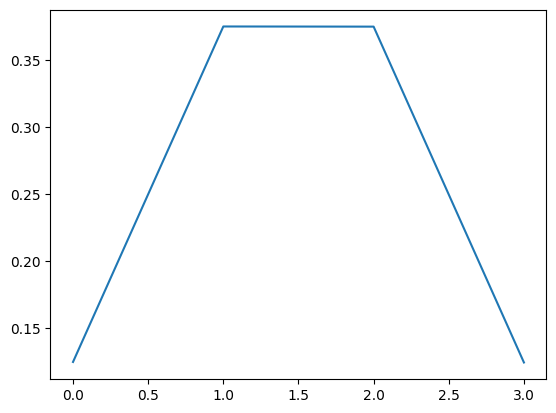

In [ ]:
N = 1000000
M = 3
heads = np.zeros(M+1)

for i in range(N):
  flips = np.random.randint(0, 2, M)
  h, _ =np.bincount(flips, minlength = 2)
  heads[h] += 1
prob = heads/N
print("Probabilities: %s" % np.array2string(prob))
plt.plot(prob)

**The Birthday Paradox**
- On average, how many people do we need together in a room to have a higher than 50 percent chance that two of them share the same birthday? This problem is known as the birthday paradox.

In [ ]:
prob = 0.5 # 50%
for i in range(300):
  if ((364/365)**i < prob):
    n = i
    print("The No. of comparisons = ", i)
    break

for j in range(n):
  if (math.comb(j,2) >= n):
    print("The minimum No. of students required in the class = ", j)
    break

The No. of comparisons =  253
The minimum No. of students required in the class =  23


In [ ]:
match = 0
for i in  range(100000):
  a = np.random.randint(0,364)
  b = np.random.randint(0,364)
  if (a == b):
    match += 1
print("Probability of a random match = %0.6f" % (match/100000,))

Probability of a random match = 0.002770


 2 0.002720
 3 0.008410
 4 0.016460
 5 0.027450
 6 0.040220
 7 0.055450
 8 0.073660
 9 0.096860
10 0.117450
11 0.140060
12 0.166210
13 0.194240
14 0.224140
15 0.252760
16 0.283000
17 0.312570
18 0.347380
19 0.378530
20 0.411390
21 0.444810
22 0.477840
23 0.505990
24 0.535810
25 0.570050
26 0.599230
27 0.628630
28 0.653890
29 0.681200
30 0.706580


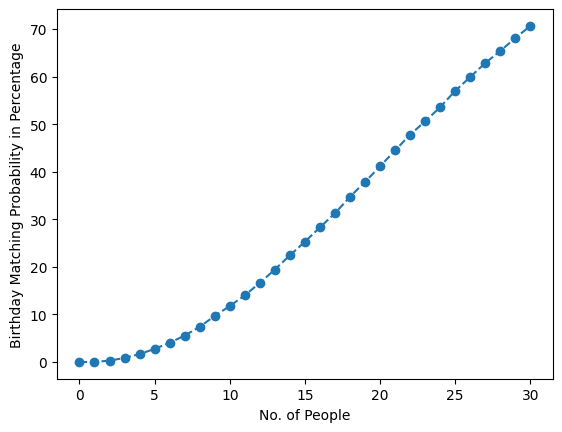

CPU times: user 7min 45s, sys: 11.2 s, total: 7min 56s
Wall time: 7min 56s


In [ ]:
%%time
l = np.zeros(31)
for m in range(2,31):
  matches = 0
  for i in range(100000):
    match = 0
    b = np.random.randint(0, 364, m)
    for i in range(m):
      for j in range(m):
        if (i != j) and (b[i] == b[j]):
          match += 1
    if (match != 0):
      matches += 1
  print("%2d %0.6f" % (m, matches/100000))
  l[m] = m
  l[m] = matches/1000
plt.plot(l, "--o")
plt.xlabel("No. of People")
plt.ylabel("Birthday Matching Probability in Percentage")
plt.show()

Say we’re very social and have 50 people at our party. Four of the 50 people have been to Boston in the fall. We pick three people at random. What’s the probability that none of them have been to Boston in the fall?

In [ ]:
%%time
nb = 0
N = 100000
for i in range(N):
  s = np.random.randint(0, 50, 3)
  fail = False
  for t in range(3):
    if (s[t] < 4):
      fail = True
  if (not fail):
    nb += 1
print("No Boston in the Fall = %0.4f" % (nb/N,))

No Boston in the Fall = 0.7783
CPU times: user 1.42 s, sys: 62.5 ms, total: 1.49 s
Wall time: 1.47 s


### More Probability

#### The Uniform Distribution

First, we’ll randomly sample integers in [0,9] and count how many of each integer we get. The counts of h tell us how many times each digit appeared. If we divide each bin of a histogram by the total of all the bins, we change from simple counts to the probability of that bin appearing.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import math

In [ ]:
n = np.random.randint(0,10,10000)
h = np.bincount(n)
print("The bincounts are: ", h)
k = h/h.sum()
print("The probabilities are: ", k)

The bincounts are:  [1060  996  976  998  997  962  962 1009 1034 1006]
The probabilities are:  [0.106  0.0996 0.0976 0.0998 0.0997 0.0962 0.0962 0.1009 0.1034 0.1006]


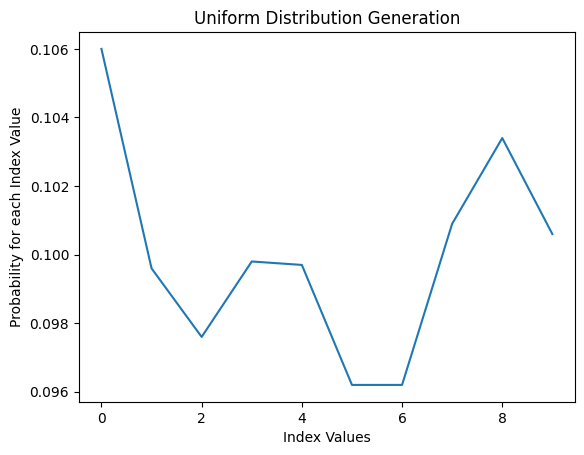

In [ ]:
plt.plot(k)
plt.xlabel("Index Values")
plt.ylabel("Probability for each Index Value")
plt.title("Uniform Distribution Generation")
plt.show()

#### Generating Distribution of an Image

Histograms are frequently used to look at the distribution of pixel values in an image. Let’s make a plot of the histogram of the pixels in a image.

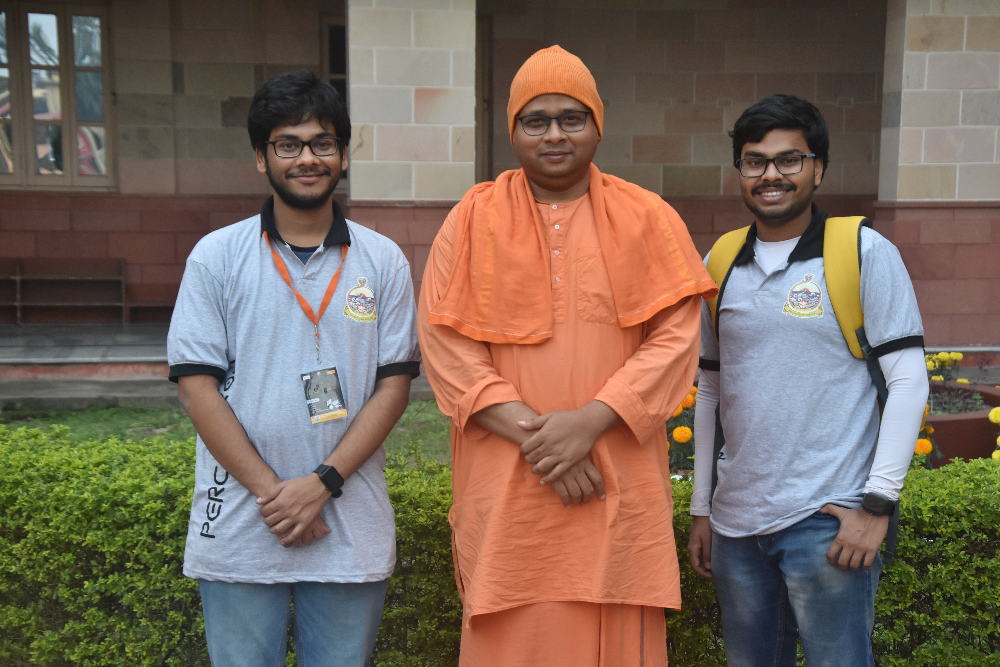

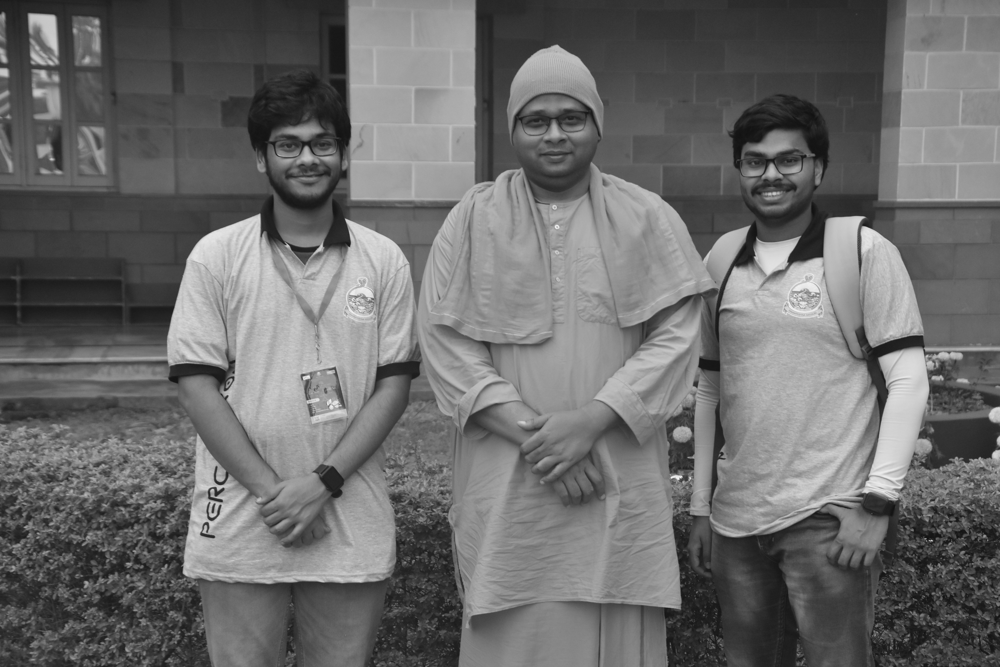

Pixel values(First 10 Elements): [23 28 29 25 27 28 26 26 28 28]
(13488000,)


In [ ]:
from PIL import Image
from IPython.display import display

# Open the image file
image_path = "/content/DSC_4677.JPG"  # Replace "your_image_path.jpg" with the path to your image file
image = Image.open(image_path)
display(image)

# Convert the image to grayscale
gray_image = image.convert("L")

# Convert the grayscale image to an array of pixel values
pixel_values = np.array(gray_image.getdata())

# Display the first few pixel values
print("Pixel values(First 10 Elements):", pixel_values[:10])

# Optionally, you can reshape the pixel values into a 2D array if needed
# For example, if the image is of size (width, height), you can reshape the pixel values into (height, width)
# pixel_values_2d = [pixel_values[i:i+image.width] for i in range(0, len(pixel_values), image.width)]
# print("Pixel values (2D):", pixel_values_2d[:10])
print(pixel_values.shape)

# img = plt.imread(image)
# plt.imshow(img)

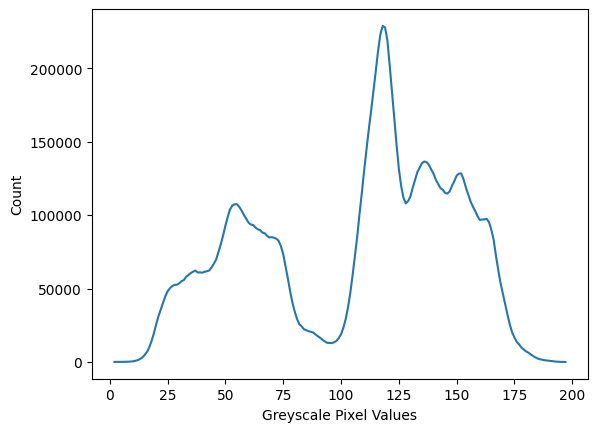

In [ ]:
unique_elements, counts = np.unique(pixel_values, return_counts=True)
# print(unique_elements)
# print(counts)
plt.plot(unique_elements, counts)
plt.xlabel("Grayscale Pixel Values")
plt.ylabel("Count")
plt.show()

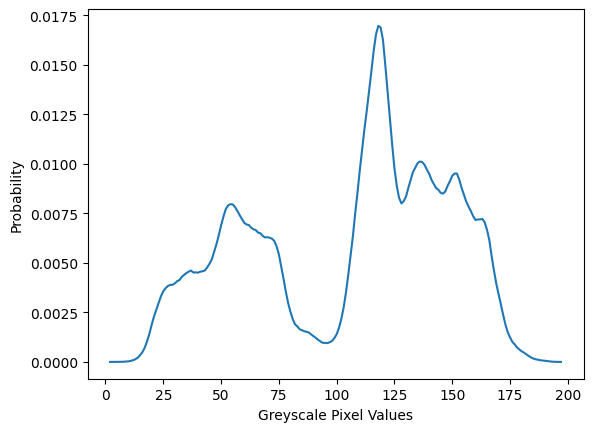

In [ ]:
plt.plot(unique_elements, counts/len(pixel_values))
plt.xlabel("Grayscale Pixel Values")
plt.ylabel("Probability")
plt.show()

#### The Binomial Distribution

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import math

In [ ]:
t1 = np.random.binomial(9, 0.3, 1000)
t2 = np.random.binomial(9, 0.5, 1000)
t3 = np.random.binomial(9, 0.7, 1000)
s1 = np.bincount(t1)
s2 = np.bincount(t2)
s3 = np.bincount(t3)
print("The bincounts are: \n", s1, "\n", s2, "\n", s3)
k1 = s1/s1.sum()
k2 = s2/s2.sum()
k3 = s3/s3.sum()
print("The probabilities are: \n", k1, "\n", k2, "\n", k3)

The bincounts are: 
 [ 43 171 266 257 147  83  27   6] 
 [  2  17  91 133 242 254 150  82  26   3] 
 [  0   0   2  22  70 172 271 264 164  35]
The probabilities are: 
 [0.043 0.171 0.266 0.257 0.147 0.083 0.027 0.006] 
 [0.002 0.017 0.091 0.133 0.242 0.254 0.15  0.082 0.026 0.003] 
 [0.    0.    0.002 0.022 0.07  0.172 0.271 0.264 0.164 0.035]


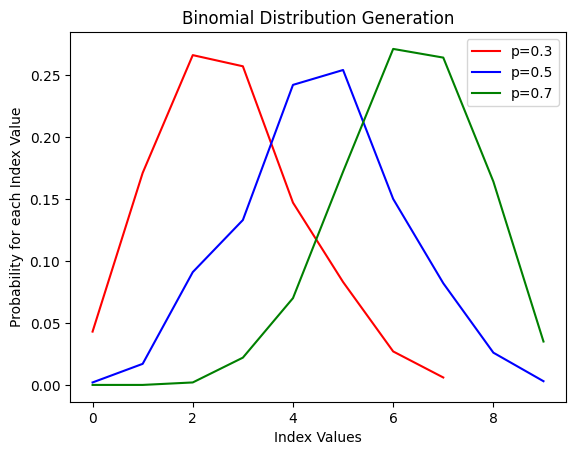

In [ ]:
plt.plot(k1, color = "red", label = "p=0.3")
plt.plot(k2, color = "blue", label = "p=0.5")
plt.plot(k3, color = "green", label = "p=0.7")
plt.xlabel("Index Values")
plt.ylabel("Probability for each Index Value")
plt.title("Binomial Distribution Generation")
plt.legend()
plt.show()

#### The Bernoulli Distribution

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import math